In [2]:
from types import SimpleNamespace as sns
import pickle
import matplotlib.pyplot as plt
import numpy as np
import kwant
import tinyarray
import scipy as sp
import pickle
from kwant.digest import uniform,gauss
import BoundState as bs
from qutip import *
from scipy.optimize import curve_fit
from scipy.interpolate import interp1d
import scipy as spi
import scipy.constants as const
import scipy.optimize as op
import scipy.misc as misc
import scipy.signal as signal
import Functions as fn
hbar = const.hbar
m_e = const.m_e
eV = const.e
mu_B = const.physical_constants['Bohr magneton'][0]

def arrange_E(E_arr,phi_arr):
    '''
    Takes the output from boundstate algorithm and the scanned phases
    and arranges them into a single list for plotting.
    '''
    new_y=[]
    new_x=[]
    for i in range(len(phi_arr)):
        for j in range(len(E_arr[i])):
            new_x.append(phi_arr[i])
            new_y.append(E_arr[i][j])
    
    return new_x,new_y
hbar = const.hbar
m_e = const.m_e
eV = const.e
mu_B = const.physical_constants['Bohr magneton'][0]

p0 = tinyarray.array([[1, 0], [0, 1]])
px = tinyarray.array([[0, 1], [1, 0]])
py = tinyarray.array([[0, -1j], [1j, 0]])
pz = tinyarray.array([[1, 0], [0, -1]])

#tau and sigma are operating on different spaces N_t=4.
tau_0=np.kron(p0,p0)
tau_x=np.kron(p0,px)
tau_y=np.kron(p0,py)
tau_z=np.kron(p0,pz)

sigma_0=np.kron(p0,p0)
sigma_x=np.kron(px,p0)
sigma_y=np.kron(py,p0)
sigma_z=np.kron(pz,p0)

def mixed_system_vary_eta(L_A=3700., W=1400., a=6.0583*10, m=0.023,
                          alpha=350., mu=0.887, U_0=0., delta=0.182, B=0.,
                          phi=0., g=14.7, salt='chizhang',eta=0.35355):
    L = int(np.round(L_A/a))
    t = (const.hbar**2.)/(2.*m*const.m_e*(a*1e-10)**2.)/const.e*1000.
    E_plus = (6.*const.hbar**2.)/(m*const.m_e*(W*1e-10)**2.)/const.e*1000.
    E_minus = (-2.*const.hbar**2.)/(m*const.m_e*(W*1e-10)**2.)/const.e*1000.
    eta = eta
    nu = alpha/(2.*a)
    B = B #changed compared to original code
    lat = kwant.lattice.chain()
    syst = kwant.Builder()
    
    # Pauli matrices
    t_x = np.kron(np.kron(np.array([[0, 1], [1, 0]]), np.eye(2)), np.eye(2)) # e-h subspace
    t_y = np.kron(np.kron(np.array([[0, -1j], [1j, 0]]), np.eye(2)), np.eye(2))
    t_z = np.kron(np.kron(np.array([[1, 0], [0, -1]]), np.eye(2)), np.eye(2))
    sigma_x = np.kron(np.kron(np.eye(2), np.array([[0, 1], [1, 0]])), np.eye(2)) # subband subspace
    sigma_y = np.kron(np.kron(np.eye(2), np.array([[0, -1j], [1j, 0]])), np.eye(2))
    sigma_z = np.kron(np.kron(np.eye(2), np.array([[1, 0], [0, -1]])), np.eye(2))
    s_x = np.kron(np.kron(np.eye(2), np.eye(2)), np.array([[0, 1], [1, 0]])) # spin subspace
    s_y = np.kron(np.kron(np.eye(2), np.eye(2)), np.array([[0, -1j], [1j, 0]]))
    s_z = np.kron(np.kron(np.eye(2), np.eye(2)), np.array([[1, 0], [0, -1]]))
    
    #### Define onsite and hopping ####
    '''def onsite(site):
    return (2.*t-mu-U_0*kwant.digest.gauss(repr(site), repr(salt)))*tau_z + B*tau_z@sigma_x'''
    
    #### Define the scattering region. ####
    ham = (2.*t+E_plus-mu)*t_z + E_minus*sigma_z@t_z + eta*s_x@sigma_y@t_z + B*s_x
    hop = -t*t_z + 1j*nu*s_y@t_z
    ham_scl = delta*(np.cos(-phi/2.)*t_x - np.sin(-phi/2.)*t_y)
    ham_scr = delta*(np.cos(phi/2.)*t_x - np.sin(phi/2.)*t_y)

    syst[(lat(x) for x in range(0, L))] = ham
    #syst[(lat(int(np.round(L/2.))))] = ham-50.*t_z
    syst[((lat(x), lat(x+1)) for x in range(0, L-1))] = hop
    
    #### Define the leads. ####
    sym_left = kwant.TranslationalSymmetry([-1])
    lead0 = kwant.Builder(sym_left)
    lead0[(lat(-1))] = ham+ham_scl
    lead0[lat.neighbors()] = np.conj(hop).T
    sym_right = kwant.TranslationalSymmetry([1])
    lead1 = kwant.Builder(sym_right)
    lead1[(lat(L))] = ham+ham_scr
    lead1[lat.neighbors()] = np.conj(hop).T
    
    
    
    #### Attach the leads and return the system. ####
    syst.attach_lead(lead0)
    syst.attach_lead(lead1)
    
    return syst.finalized()

C:\Users\hht18\AppData\Local\Temp\ipykernel_6976\65255318.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


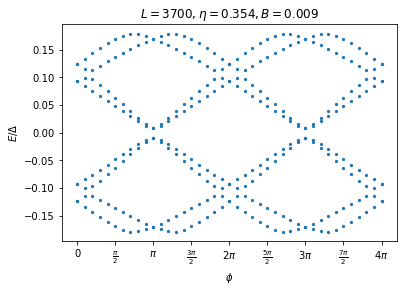

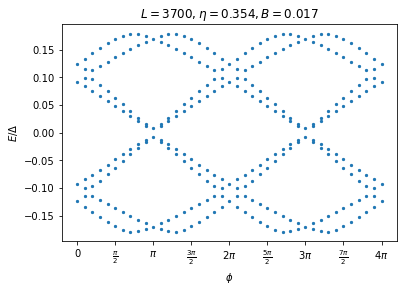

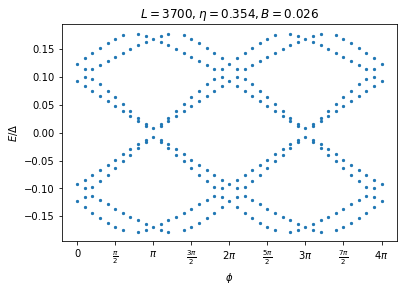

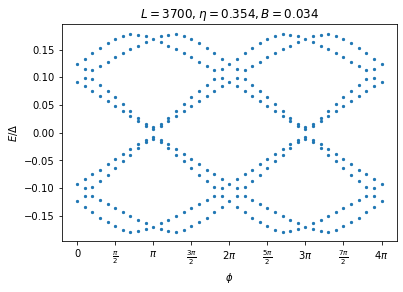

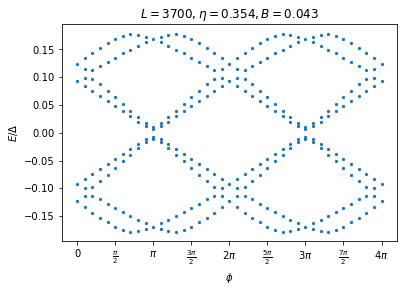

...

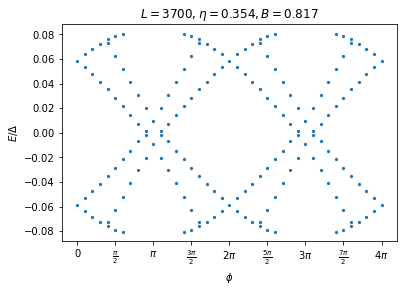

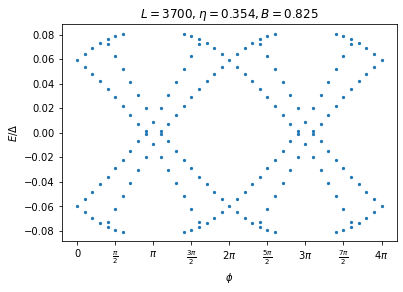

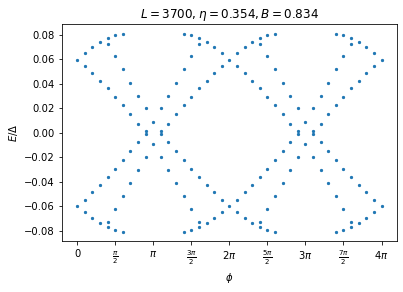

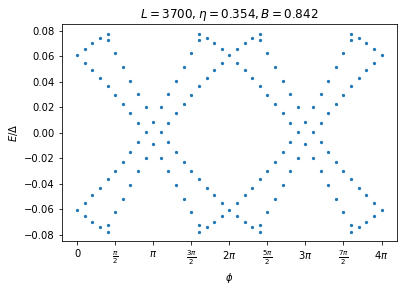

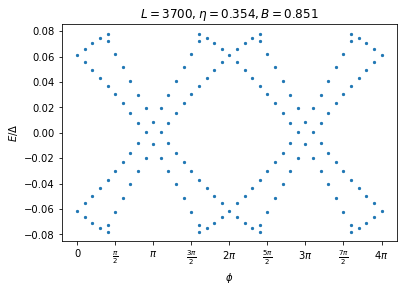

In [16]:
directory='./rerun_data/e_phi_B_rerun/'
file='e_B_index_' #1 to 100 energy arrays
file2='psi_B_index_' #1 to 100 wavefunctions

'''
counter=0
array_index=...
for i in np.linspace(B_arr[0],B_arr[1],101):
    counter+=1
    if counter<=array_index*10 and (counter>array_index-1)*10:
        en_arr=[]
        wfn_arr=[]
        for j in np.linspace(phi_arr[0],phi_arr[1],41):
            syst=make_syst_mixed(...)
            en,wfn=find_boundstates(syst,-1.1*delta,1.1*delta,rtol=delta/100)
            en_arr.append(en)
            wfn_arr.append(wfn)
        pickle.dump(en_arr,open(./data_e_B_index_%s)%(counter))
        pickle.dump(wfn...)
'''
B_arr=np.linspace(0,14.7*mu_B*2./2./eV*1000.,101)
phi_arr=np.linspace(0,4*np.pi,41)
eta=np.sqrt(2)*350./1400
for i in range(1,101,1):
    data=pickle.load(open(directory+file+'%s'%(i),'rb'))
    plt.figure()
    x,y=arrange_E(data,phi_arr)
    plt.scatter(x,y,s=5)
    plt.xticks(np.linspace(0,4*np.pi,9,endpoint=True), ['0',r'$\frac{\pi}{2}$',r'$\pi$',
                                                     r'$\frac{3\pi}{2}$',r'$2\pi$',
                                                     r'$\frac{5\pi}{2}$',r'$3\pi$',
                                                     r'$\frac{7\pi}{2}$',r'$4\pi$'])
    plt.title(r'$L=%s, \eta=%s, B=%s$'%(3700,round(eta,3),round(B_arr[i],3)))
    plt.ylabel(r'$E/\Delta$')
    plt.xlabel(r'$\phi$')
    #plt.ylim(-.1,.1)



In [20]:
B_arr[73]
np.linspace(0,2,101)[73] #equivalent magnetic field in Tesla

1.46

In [ ]:
'''
B_arr=np.linspace(0,14.7*mu_B*2./2./eV*1000.,101) #B_tesla going to 2
B=B_arr[73]
eta_arr=np.linspace(0.3,0.5,201)
phi_arr=np.linspace(0,2*np.pi,31)
delta=0.182

counter=0
elements=len(eta_arr)*len(phi_arr)
arr_ind = int(os.environ['PBS_ARRAY_INDEX'])
jobs=23
perjob=9

filename='./rerun_data/varying_eta_max_B_en'
filename2='./rerun_data/varying_eta_max_B_wfn'
save_en=[]
save_wfn=[]
for i in range(len(eta_arr)):
    en_arr=[]
    wfn_arr=[]
    counter+=1
    if (arr_ind*perjob)<counter<=((arr_ind+1)*perjob):
        for j in range(len(phi_arr)):
            syst=mixed_system_vary_eta(B=B,phi=phi_arr[j],eta=eta_arr[i])
            en,wfn=bs.find_boundstates(syst,-1.05*delta,1.05*delta,rtol=delta/100)
            en_arr.append(en)
            wfn_arr.append(wfn)
        save_en.append(en_arr)
        save_wfn.append(wfn_arr)
        pickle.dump(save_en,open(filename+'%s'%(str(arr_ind)),'wb'))
        pickle.dump(save_wfn,open(filename2+'%s'%(str(arr_ind)),'wb'))        
'''
problematic indices: 5,16,17

## 2D color plot


C:\Users\hht18\AppData\Local\Temp\ipykernel_4388\1822357208.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()
C:\Users\hht18\AppData\Local\Temp\ipykernel_4388\1822357208.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()
C:\Users\hht18\AppData\Local\Temp\ipykernel_4388\1822357208.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see th

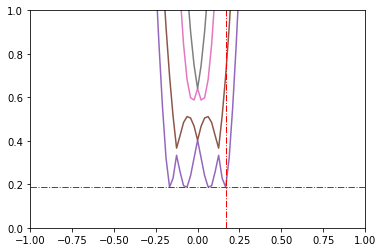

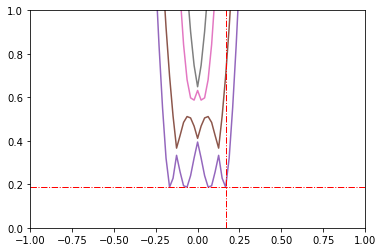

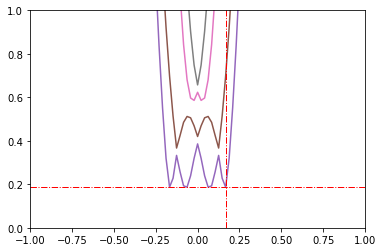

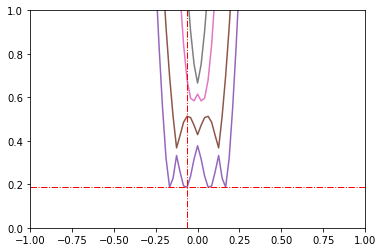

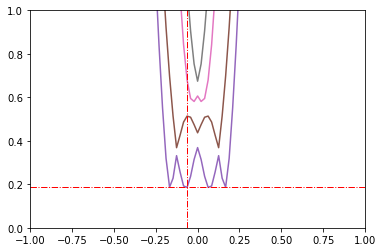

...

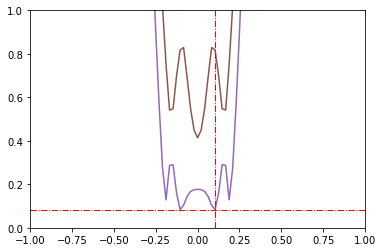

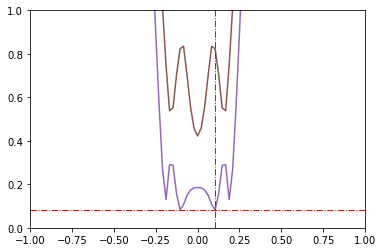

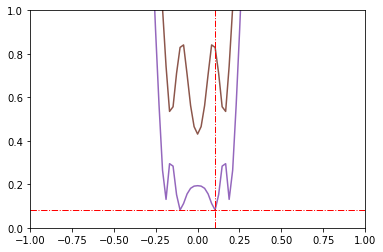

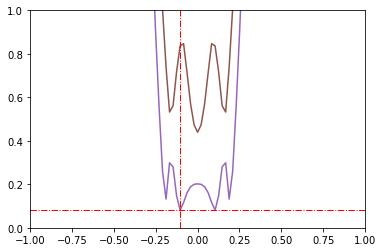

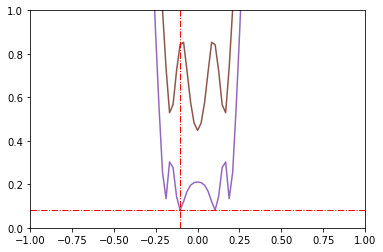

In [19]:
#can first plot the topological transition to determine what 2d parameters we want.
B_arr=np.linspace(0,14.7*mu_B*2./2./eV*1000.,101)
eta_arr=np.linspace(0.2,0.5,301)

# aight this works. just use argmin, don't track momentum minima
for i in range(150,151):
    for j in range(len(B_arr)):
        JJ=mixed_system_vary_eta(B=B_arr[j],eta=eta_arr[i])
        bands=kwant.physics.dispersion.Bands(JJ.leads[0])
        momenta =np.linspace(-np.pi, np.pi, 301)
        energies = np.array([bands(k) for k in momenta])
        
        lngth=energies.shape[1]
        save_index=int(lngth/2)
        plt.figure()
        plt.plot(momenta,energies)
        minind=np.argmin(energies[:,save_index])
        plt.axhline(energies[minind,save_index],linewidth=1,color='r',linestyle='-.')
        plt.axvline(momenta[minind],linewidth=1,color='r',linestyle='-.')
        plt.ylim(0,1)
        plt.xlim(-1,1)
        plt.savefig('./rerun_data/test%s%s'%(i,j))

In [2]:
#plt works; now make the 2d plot of phase transition
B_arr=np.linspace(0,14.7*mu_B*2./2./eV*1000.,1001)
eta_arr=np.linspace(0.2,0.5,301)

# aight this works. just use argmin, don't track momentum minima

en_arr=np.ones((len(eta_arr),len(B_arr)))
for i in range(len(eta_arr)):
    for j in range(len(B_arr)):
        JJ=mixed_system_vary_eta(B=B_arr[j],eta=eta_arr[i])
        bands=kwant.physics.dispersion.Bands(JJ.leads[0])
        momenta =np.linspace(0., .5, 501)
        energies = np.array([bands(k) for k in momenta])
        
        lngth=energies.shape[1]
        save_index=int(lngth/2)
        minind=np.argmin(energies[:,save_index])
        en_arr[i,j]=energies[minind,save_index]

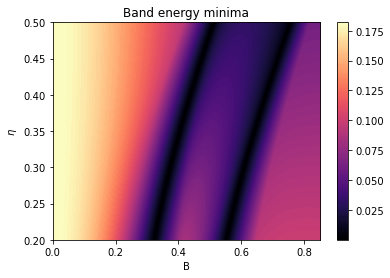

In [30]:
import matplotlib as mpl

cbar = mpl.cm.get_cmap("magma", 100)
plt.imshow(test_arr, aspect = 'auto', extent=[min(B_arr),max(B_arr),min(eta_arr), max(eta_arr)],
           origin='lower',cmap=cbar)
plt.ylabel(r'$\eta$')
plt.xlabel('B')
plt.title('Band energy minima')
plt.colorbar()
plt.savefig('./rerun_data/2d_topo_transition',dpi=300)
plt.show()

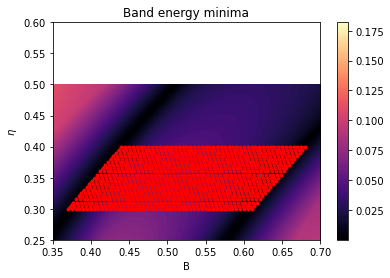

In [85]:
en_arr=pickle.load(open('./rerun_data/2d_topo_transition_data','rb'))
B_arr=np.linspace(0,14.7*mu_B*2./2./eV*1000.,1001)
eta_arr=np.linspace(0.2,0.5,301)
cbar = mpl.cm.get_cmap("magma", 100)
test_arr=en_arr.copy()
#rows are eta, columns are B
im=plt.imshow(test_arr, aspect = 'auto', extent=[ min(B_arr),max(B_arr),min(eta_arr), max(eta_arr)], origin='lower',cmap=cbar)
plt.ylabel(r'$\eta$')
plt.xlabel('B')
plt.title('Band energy minima')
plt.colorbar()

y=lambda x: 0.30+(x-.37)*(.1/0.07)
y2=lambda x: 0.30+(x-.61)*(.1/0.07)

#for actual simulation, will probably need to write a function to get B in terms of eta

sim_eta_arr=np.linspace(0.3,0.4,21)
f = lambda eta: np.linspace(0.37+0.7*(eta-0.3),0.37+0.7*(eta-0.3)+0.24,49)

sim_arr=np.ones((49,21))
for i in range(21):
    sim_arr[:,i]=f(sim_eta_arr[i])
    
plt.plot(np.linspace(0.37,0.44,1000),y(np.linspace(0.37,0.44,1000)),color='r',linestyle='-.')
plt.plot(np.linspace(0.61,0.68,1000),y2(np.linspace(0.61,0.68,1000)),color='r',linestyle='-.')
plt.plot(np.linspace(0.37,0.61,100),[.3]*100,color='r',linestyle='-.')
plt.plot(np.linspace(0.44,0.68,100),[.4]*100,color='r',linestyle='-.')
plt.plot(B_arr[730],0.35355,'o',markersize=3)
for i in range(len(sim_eta_arr)):
    plt.plot(sim_arr[:,i],[sim_eta_arr[i]]*49,'.',color='r')
#plt.savefig('./rerun_data/2d_topo_transition_wanttosimulate',dpi=300)
plt.xlim(0.35,0.7)
plt.ylim(0.25,0.6)
plt.show()
# okay, we can simulate this square

In [99]:
d1=pickle.load(open('varying_eta_max_B_eta16_1','rb'))
d0=pickle.load(open('varying_eta_max_B_eta16','rb'))
print(len(d0))
print(len(d1)) #need to change the thing. changed. but only 15??? Might still have something wrong with code..
print(d0)
print(d1)

15
14
[0.3, 0.301, 0.302, 0.303, 0.304, 0.305, 0.306, 0.444, 0.44499999999999995, 0.44599999999999995, 0.44699999999999995, 0.44799999999999995, 0.44899999999999995, 0.44999999999999996, 0.45199999999999996]
[0.3, 0.301, 0.302, 0.303, 0.304, 0.305, 0.306, 0.444, 0.44499999999999995, 0.44599999999999995, 0.44699999999999995, 0.44799999999999995, 0.44899999999999995, 0.44999999999999996]


In [22]:
#delete wavefunctions, it's taking too much space, save as new
filename='./rerun_data/Data/2D_plot_vary_eta_B'
new_fname='./rerun_data/Data/2D_plot_vary_eta_B_no_wfn'

#indices=[2,3,9,20,21,23] DONE ALL
for i in indices:
    data=pickle.load(open(filename+'%s'%(i),'rb'))
    data=data.copy()
    for j in range(len(data)):
        del data[j][3]
    pickle.dump(data,open(new_fname+'%s'%(i),'wb'))

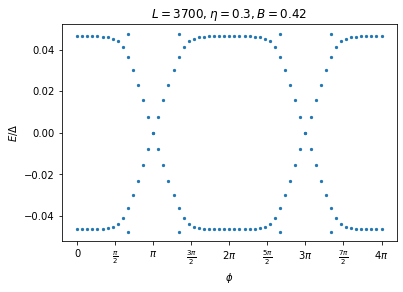

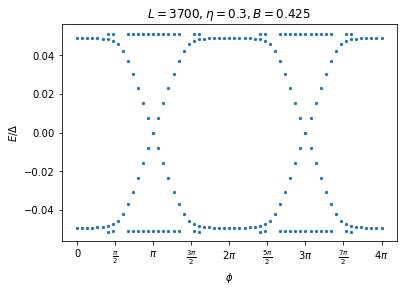

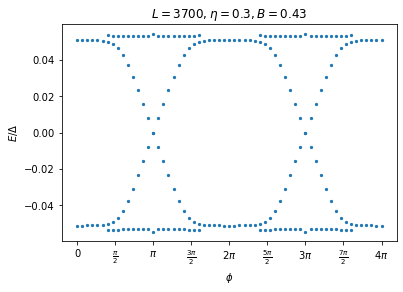

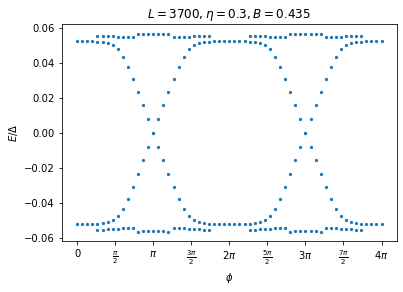

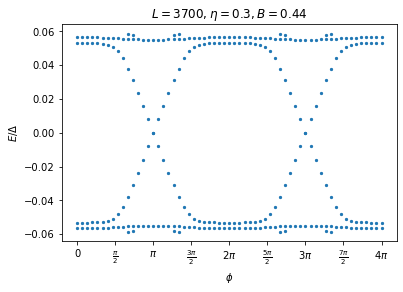

...

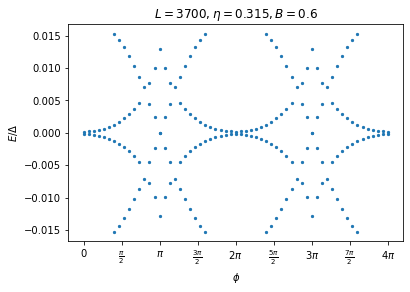

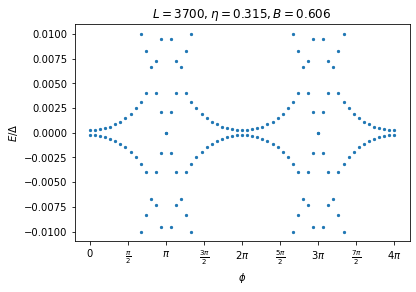

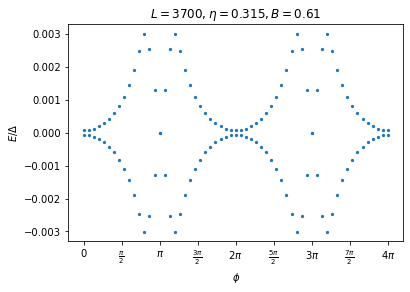

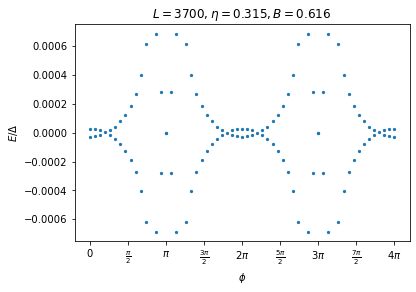

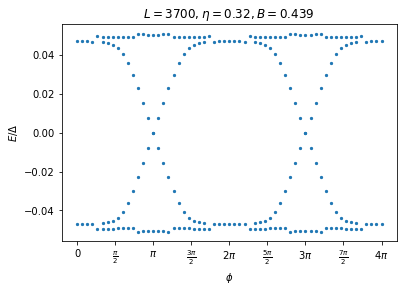

KeyboardInterrupt: 

In [2]:
filename='./rerun_data/Data/2D_plot_vary_eta_B_no_wfn'
sim_eta_arr=np.linspace(0.3,0.4,21)
f = lambda eta: np.linspace(0.37+0.7*(eta-0.3),0.37+0.7*(eta-0.3)+0.24,49)
phi_arr=np.linspace(0,2*np.pi,31)
data=pickle.load(open(filename+'%s'%(0),'rb'))
for i in range(24):
    data=pickle.load(open(filename+'%s'%(i),'rb'))
    for j in range(len(data)):
        eta_ind=data[j][0]
        B_ind=data[j][1]
        en=data[j][2]
        if en[15].size:
            if np.any(abs(en[15])<=1e-10): #ensure there is majorana solution
                if en[0].size:
                    n_en,n_phi=fn.process_data(en,phi_arr,fill=True,extend=True,single=True)
                    x,y=arrange_E(n_en,n_phi)
                    plt.figure()
                    plt.scatter(x,y,s=5)
                    plt.xticks(np.linspace(0,4*np.pi,9,endpoint=True), ['0',r'$\frac{\pi}{2}$',r'$\pi$',
                                                                     r'$\frac{3\pi}{2}$',r'$2\pi$',
                                                                     r'$\frac{5\pi}{2}$',r'$3\pi$',
                                                                     r'$\frac{7\pi}{2}$',r'$4\pi$'])
                    plt.title(r'$L=%s, \eta=%s, B=%s$'%(3700,round(sim_eta_arr[eta_ind],3),round(f(sim_eta_arr[eta_ind])[B_ind],3)))
                    plt.ylabel(r'$E/\Delta$')
                    plt.xlabel(r'$\phi$')
                    plt.show()
                
            
            
            '''

            
            index=int(len(n_en[0])/2)
            branch,phi=fn.gradient_addition(index,n_en,n_phi,printing=False)
            interx,intery=fn.interpolate(branch,phi)
            plt.figure()
            plt.scatter(x,y,s=5)
            plt.scatter(interx,intery,color='r')
            plt.xticks(np.linspace(0,4*np.pi,9,endpoint=True), ['0',r'$\frac{\pi}{2}$',r'$\pi$',
                                                             r'$\frac{3\pi}{2}$',r'$2\pi$',
                                                             r'$\frac{5\pi}{2}$',r'$3\pi$',
                                                             r'$\frac{7\pi}{2}$',r'$4\pi$'])
            plt.title(r'$L=%s, \eta=%s, B=%s$'%(3700,round(sim_eta_arr[eta_ind],3),round(f(sim_eta_arr[eta_ind])[B_ind],3)))
            plt.ylabel(r'$E/\Delta$')
            plt.xlabel(r'$\phi$')
            plt.show()
            '''


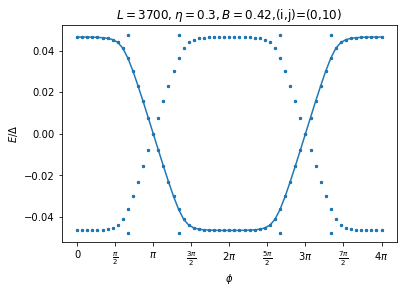

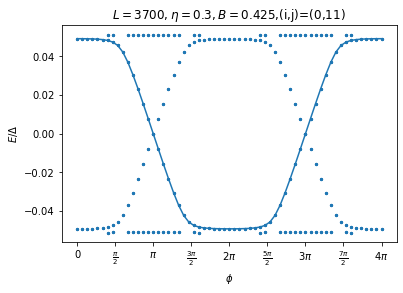

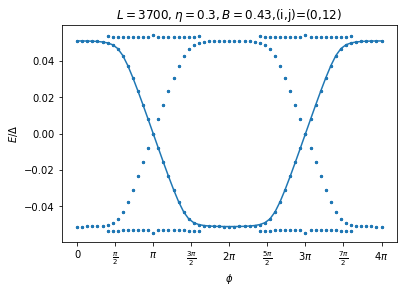

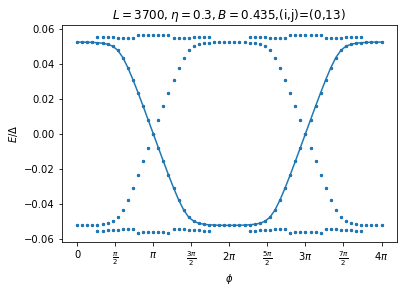

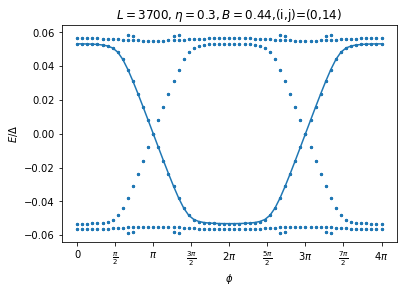

...

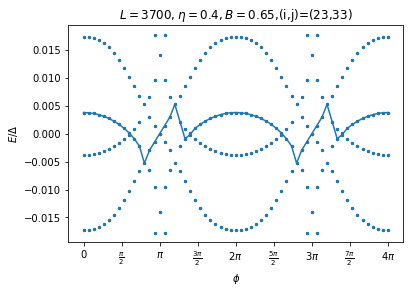

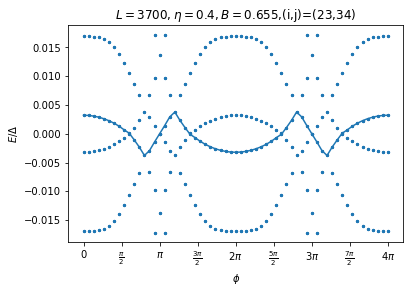

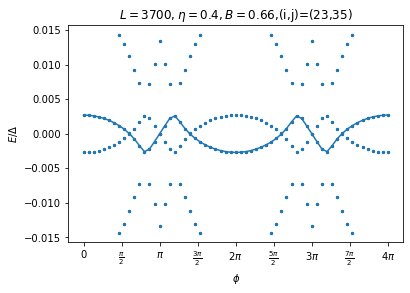

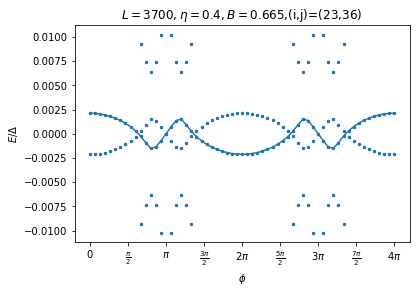

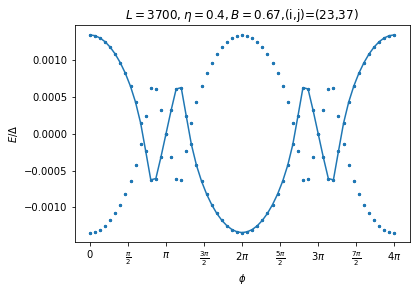

In [2]:

import Functions as fn
filename='./rerun_data/Data/2D_plot_vary_eta_B_no_wfn'
sim_eta_arr=np.linspace(0.3,0.4,21)
f = lambda eta: np.linspace(0.37+0.7*(eta-0.3),0.37+0.7*(eta-0.3)+0.24,49)
phi_arr=np.linspace(0,2*np.pi,31)
data=pickle.load(open(filename+'%s'%(0),'rb'))

okay_indices=[]
for i in range(24):
    data=pickle.load(open(filename+'%s'%(i),'rb'))
    for j in range(len(data)):
        eta_ind=data[j][0]
        B_ind=data[j][1]
        en=data[j][2]
        if en[15].size:
            if np.any(abs(en[15])<=1e-10): #ensure there is majorana solution
                if en[0].size:
                    okay_indices.append((i,j))
                    
                    n_en,n_phi=fn.process_data(en,phi_arr,fill=True,extend=True,single=True)
                    n_en[0]=np.sort(n_en[0])
                    index=int(len(n_en[0])/2)
                    branch,phi=fn.new_gradient_addition(n_en,n_phi)
                    x,y=arrange_E(n_en,n_phi)
                    plt.figure()
                    plt.scatter(x,y,s=5)
                    plt.plot(phi,branch)
                    plt.xticks(np.linspace(0,4*np.pi,9,endpoint=True), ['0',r'$\frac{\pi}{2}$',r'$\pi$',
                                                                     r'$\frac{3\pi}{2}$',r'$2\pi$',
                                                                     r'$\frac{5\pi}{2}$',r'$3\pi$',
                                                                     r'$\frac{7\pi}{2}$',r'$4\pi$'])
                    plt.title(r'$L=%s, \eta=%s, B=%s$,(i,j)=(%s,%s)'%(3700,round(sim_eta_arr[eta_ind],3),
                                                                      round(f(sim_eta_arr[eta_ind])[B_ind],3),i,j))
                    plt.ylabel(r'$E/\Delta$')
                    plt.xlabel(r'$\phi$')
                    plt.show()


In [6]:
# fourier analysis
import Functions as fn
filename='./rerun_data/Data/2D_plot_vary_eta_B_no_wfn'
sim_eta_arr=np.linspace(0.3,0.4,21)
f = lambda eta: np.linspace(0.37+0.7*(eta-0.3),0.37+0.7*(eta-0.3)+0.24,49)
phi_arr=np.linspace(0,2*np.pi,31)
data=pickle.load(open(filename+'%s'%(0),'rb'))

okay_indices=[]
coeff_arr=np.zeros((len(sim_eta_arr),49,10)) #eta, B, modes
for i in range(24):
    data=pickle.load(open(filename+'%s'%(i),'rb'))
    for j in range(len(data)):
        eta_ind=data[j][0]
        B_ind=data[j][1]
        en=data[j][2]
        if en[15].size:
            if np.any(abs(en[15])<=1e-10): #ensure there is majorana solution
                if en[0].size:
                    okay_indices.append((i,j))

                    n_en,n_phi=fn.process_data(en,phi_arr,fill=True,extend=True,single=True)
                    n_en[0]=np.sort(n_en[0])
                    index=int(len(n_en[0])/2)
                    branch,phi=fn.new_gradient_addition(n_en,n_phi)
                    
                    interx,intery=fn.interpolate(branch,phi)
                    intery=intery/1000*1.6*10**-19/(6.63*10**-34)
                    coeffs=fn.fourier_decompose(intery,interx,modes=10,offset=False)
                    coeff_arr[eta_ind,B_ind,:]=coeffs
print(coeff_arr)

[[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
    0.00000000e+00  0.00000000e+00]
  [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
    0.00000000e+00  0.00000000e+00]
  [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
    0.00000000e+00  0.00000000e+00]
  ...
  [ 3.93937810e+08  2.31935783e+05 -4.50909315e+08 ...  2.31939734e+05
    6.10231670e+07  2.31941718e+05]
  [ 1.09713376e+08  4.57199904e+04 -1.41522594e+08 ...  4.57215735e+04
    1.35517312e+07  4.57223727e+04]
  [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
    0.00000000e+00  0.00000000e+00]]

 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
    0.00000000e+00  0.00000000e+00]
  [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
    0.00000000e+00  0.00000000e+00]
  [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
    0.00000000e+00  0.00000000e+00]
  ...
  [ 3.36640854e+08  1.6

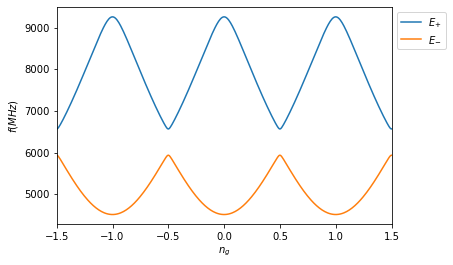

In [14]:
Ec=512*10**6
Ej=4.7*10**9
ng=np.linspace(-2,2,9+8*60)
energy_array=np.zeros((len(sim_eta_arr),49))
for i in range(24):
    data=pickle.load(open(filename+'%s'%(i),'rb'))
    for j in range(len(data)):
        eta_ind=data[j][0]
        B_ind=data[j][1]
        en=data[j][2]
        if en[15].size:
            if np.any(abs(en[15])<=1e-10): #ensure there is majorana solution
                if en[0].size:
                    levels=50
                    energies=np.array([fn.qubit_energies(Ec,Ej,coeff_arr[eta_ind,B_ind,:],levels,g)/10**6 for g in ng])
                    split=min(energies[:,3]-energies[:,0]-(energies[:,2]-energies[:,1]))
                    energy_array[eta_ind,B_ind]=split
plt.figure()
plt.xlabel(r'$n_g$')
plt.ylabel(r'$f(MHz)$')
plt.plot(ng,energies[:,3]-energies[:,0],label='$E_{+}$')
plt.plot(ng,energies[:,2]-energies[:,1],label='$E_{-}$')

plt.xlim(-1.5,1.5)
#plt.ylim(0,13500)
plt.legend(bbox_to_anchor=(1.0, 1.0), loc='upper left')

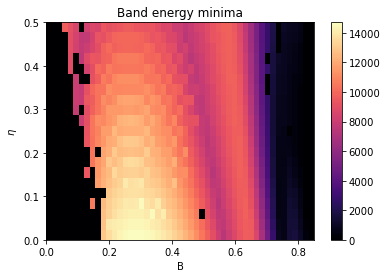

In [17]:
sim_eta_arr=np.linspace(0.3,0.4,21)
f = lambda eta: np.linspace(0.37+0.7*(eta-0.3),0.37+0.7*(eta-0.3)+0.24,49)

cbar = mpl.cm.get_cmap("magma", 200)
im=plt.imshow(energy_array, aspect = 'auto', extent=[ min(B_arr),max(B_arr),min(eta_arr), max(eta_arr)], origin='lower',cmap=cbar)
plt.ylabel(r'$\eta$')
plt.xlabel('B')
plt.title('Band energy minima')
plt.colorbar()

plt.show()
# okay, we can simulate this square

C:\Users\hht18\AppData\Local\Temp\ipykernel_10420\3114600446.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


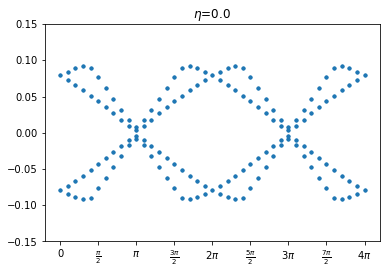

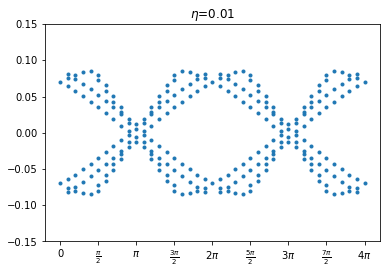

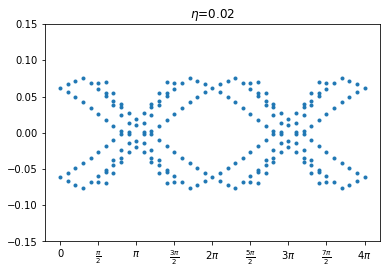

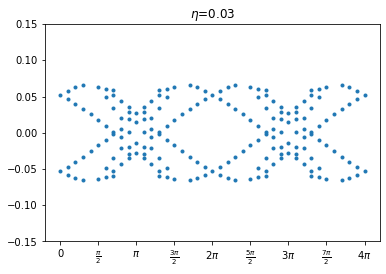

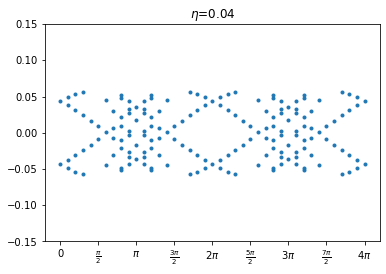

...

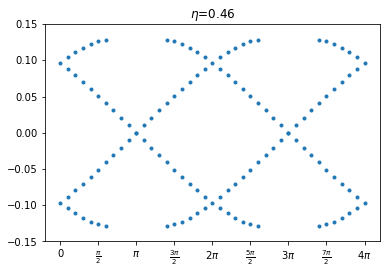

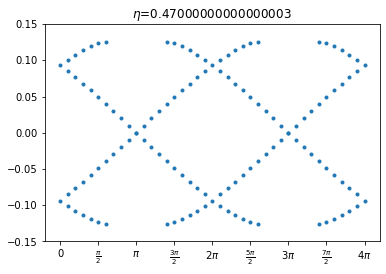

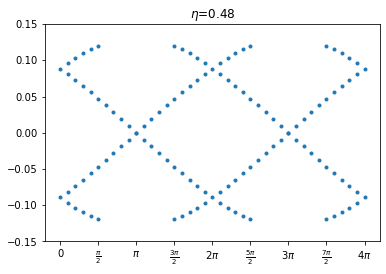

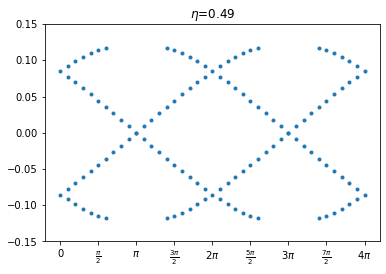

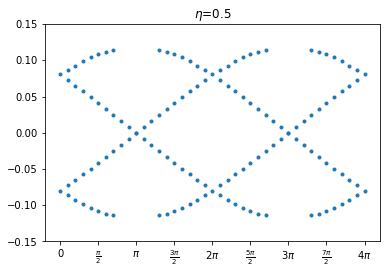

In [17]:
filename='./rerun_data/Data/e_eta_index_'
phi_arr=np.linspace(0,4*np.pi,41)
eta_arr=np.linspace(0,0.5,51)
for i in range(1,52):
    data=pickle.load(open(filename+'%s'%(i),'rb'))
    x,y=arrange_E(data,phi_arr)
    plt.figure()
    plt.plot(x,y,'.')
    plt.title('$\eta$=%s'%(eta_arr[i-1]))
    plt.ylim(-.15,.15)
    plt.xticks(np.linspace(0,4*np.pi,9,endpoint=True), ['0',r'$\frac{\pi}{2}$',r'$\pi$',
                                                     r'$\frac{3\pi}{2}$',r'$2\pi$',
                                                     r'$\frac{5\pi}{2}$',r'$3\pi$',
                                                     r'$\frac{7\pi}{2}$',r'$4\pi$'])
    plt.savefig('./rerun_data/e_eta_index_%s'%(i),dpi=300)

# Color plot varying eta directly to compare with Chi

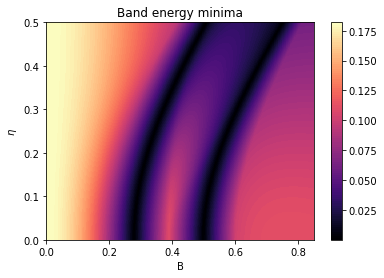

In [5]:
#run after getting new data from hpc
filename='./rerun_data/Data/2D_colorplot_vary_etaB'
data=pickle.load(open(filename,'rb'))
eta_arr=np.linspace(0.,0.5,501)
B_arr=np.linspace(0,14.7*mu_B*2./2./eV*1000.,201)


'''
en_arr=np.ones((len(eta_arr),len(B_arr)))
for i in range(len(eta_arr)):
    for j in range(len(B_arr)):
        JJ=mixed_system_vary_eta(B=B_arr[j],eta=eta_arr[i])
        bands=kwant.physics.dispersion.Bands(JJ.leads[0])
        momenta =np.linspace(0., 1.,2001)
        energies = np.array([bands(k) for k in momenta])
        lngth=energies.shape[1]
        save_index=int(lngth/2)
        minind=np.argmin(energies[:,save_index])
        en_arr[i,j]=energies[minind,save_index]
pickle.dump(en_arr,open(filename,'wb'))
'''

import matplotlib as mpl

cbar = mpl.cm.get_cmap("magma", 100)
plt.imshow(data, aspect = 'auto', extent=[min(B_arr),max(B_arr),min(eta_arr), max(eta_arr)],
           origin='lower',cmap=cbar)
plt.ylabel(r'$\eta$')
plt.xlabel('B')
plt.title('Band energy minima')
plt.colorbar()
plt.savefig('./rerun_data/2d_topo_transition_biggerpicture',dpi=300)
plt.show()

In [13]:
from scipy.signal import argrelextrema
eta_arr=np.linspace(0.,0.5,501)
B_arr=np.linspace(0,14.7*mu_B*2./2./eV*1000.,201)

filename='./rerun_data/Data/2D_colorplot_conecounting'
sum_arr=np.ones((len(eta_arr),len(B_arr)))
for i in range(len(eta_arr)):
    for j in range(len(B_arr)):
        JJ=mixed_system_vary_eta(B=B_arr[j],eta=eta_arr[i])
        bands=kwant.physics.dispersion.Bands(JJ.leads[0])
        momenta =np.linspace(-.6, .6,601)
        energies = np.array([bands(k) for k in momenta])
        lngth=energies.shape[1]
        save_index=int(lngth/2)
        minsum=len(argrelextrema(energies[:,save_index], np.less)[0])
        sum_arr[i,j]=minsum
pickle.dump(sum_arr,open(filename,'wb'))

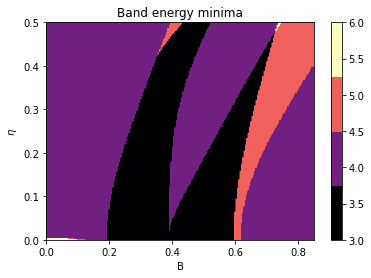

In [20]:
filename='./rerun_data/Data/2D_colorplot_conecounting'
data=pickle.load(open(filename,'rb'))
eta_arr=np.linspace(0.,0.5,501)
B_arr=np.linspace(0,14.7*mu_B*2./2./eV*1000.,201)


import matplotlib as mpl

cbar = mpl.cm.get_cmap("magma",4)
plt.imshow(data, aspect = 'auto', extent=[min(B_arr),max(B_arr),min(eta_arr), max(eta_arr)],
           origin='lower',cmap=cbar,vmin=3,vmax=6)
plt.ylabel(r'$\eta$')
plt.xlabel('B')
plt.title('Band energy minima')
plt.colorbar()
plt.savefig('./rerun_data/2d_topo_transition_biggerpicture_cones',dpi=300)
plt.show()

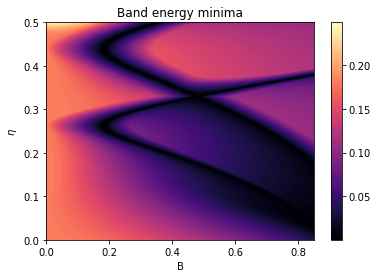

In [2]:
'''
filename='./rerun_data/2D_colorplot_vary_W'


B_arr=np.linspace(0,14.7*mu_B*2./2./eV*1000.,201)
eta_arr=np.linspace(0.001,0.501,501)
f = lambda eta,alpha: np.sqrt(2)*alpha/eta
alpha=350.

en_arr=np.ones((len(eta_arr),len(B_arr)))
for i in range(len(eta_arr)):
    for j in range(len(B_arr)):
        W=f(eta_arr[i],alpha)
        JJ=mixed_system_vary_W(B=B_arr[j],W=W)
        bands=kwant.physics.dispersion.Bands(JJ.leads[0])
        momenta =np.linspace(0., 1.,2001)
        energies = np.array([bands(k) for k in momenta])
        lngth=energies.shape[1]
        save_index=int(lngth/2)
        minind=np.argmin(energies[:,save_index])
        en_arr[i,j]=energies[minind,save_index]
pickle.dump(en_arr,open(filename,'wb'))
'''
filename='./rerun_data/Data/2D_colorplot_vary_W'
data=pickle.load(open(filename,'rb'))
eta_arr=np.linspace(0.,0.5,501)
B_arr=np.linspace(0,14.7*mu_B*2./2./eV*1000.,201)

import matplotlib as mpl

cbar = mpl.cm.get_cmap("magma", 100)
plt.imshow(data, aspect = 'auto', extent=[min(B_arr),max(B_arr),min(eta_arr), max(eta_arr)],
           origin='lower',cmap=cbar)
plt.ylabel(r'$\eta$')
plt.xlabel('B')
plt.title('Band energy minima')
plt.colorbar()
plt.savefig('./rerun_data/2d_topo_transition_varyW',dpi=300)
plt.show()